# lesson5. Python主要ライブラリの紹介 part2 - matplotlib -

## 5-0. 準備
matplotlibで簡単に日本語表示ができるjapanize_matplotlibをインストールしておきます。<br>

In [53]:
%%bash
pip install -U pip
pip install japanize_matplotlib

In [54]:
import sys
import os
sys.path.append(os.pardir)
from lib.backlog import Backlog

ORG = os.environ["BACKLOG_ORG"]
API_KEY = os.environ["BACKLOG_API_KEY"]
PJ_ID = os.environ["PROJECT_ID"]
backlog = Backlog(organization=ORG, api_key=API_KEY, project_id=PJ_ID)
backlog.get_file_metadatas(target_dir="python")
backlog.get_file(target_dir="python", save_dir="./", meta={"id":34506745, "name":"Tokyo_20200101_20221231.csv"})

## 5-1. 基礎的なグラフ描画

プログラムでどんなことがしたいかは人それぞれですが、多くの場合なんらかの計算を行います。<br>
一方、作成したプログラムから得られる計算結果が妥当かどうか確認するためには、グラフ表示など<br>
視覚的にわかりやすい情報にして確認することが多いです。<br>

matplotlibはグラフ描画に特化したライブラリで、2次元のグラフ表示以外にも3次元プロットやアニメーションの作成なども行えます。<br>
また、MATLAB(MathWorks社製製品)の利用経験があるユーザが簡単に習得しやすいように設計されています。<br>
まずは、必要なライブラリをimportしましょう。

In [55]:
import pandas as pd
import japanize_matplotlib
import matplotlib.pyplot as plt

次に必要なデータをpandasのデータフレームに格納します。<br>
使用するデータは[前回](./lesson4.ipynb)と同様のものです。

In [56]:
df = pd.read_csv("Tokyo_20200101_20221231.csv")
df

,date,mean_temparture,max_temparture,min_temparture,mean_wind_speed,max_wind_speed,max_moment_wind_speed,most_wind_direction,mean_cloud_cover,total_precipitation,mean_humidity
0,2020/1/1,5.5,10.2,3.2,2.6,6.1,11.8,北北西,3.0,0.0,49
1,2020/1/2,6.2,11.3,1.9,1.8,3.3,5.3,北,1.0,0.0,60
2,2020/1/3,6.1,12.0,1.4,1.4,3.0,4.6,北西,0.0,0.0,63
3,2020/1/4,7.2,12.2,3.6,2.3,5.2,10.8,北北西,5.5,0.0,53
4,2020/1/5,5.4,10.2,0.6,3.0,6.3,12.4,北西,0.0,1.0,61
...,...,...,...,...,...,...,...,...,...,...,...
1091,2022/12/27,6.8,12.3,2.0,2.7,7.5,12.5,北西,0.0,0.0,48
1092,2022/12/28,6.5,11.9,2.8,1.4,3.5,5.9,北北東,3.3,0.0,61
1093,2022/12/29,8.1,13.7,2.9,2.0,4.6,7.8,北西,0.0,0.0,51
1094,2022/12/30,6.6,11.8,2.8,1.9,3.5,7.3,北西,3.3,0.0,51


matplotlibではいろいろなグラフ描画に対応するため、少し煩雑な操作が必要になります。<br>
まずは、最も一般的な描画パターンを説明します。

``` python
ここに描画操作を記述

plt.show()
```

plt.show()で実際にグラフを描画します。<br>
plt.show()の前に様々な表示設定を記述することで柔軟なグラフ化が可能になります。<br>

まずはx軸とy軸を指定して描画するためのplt.plot()で描画してみます。

``` python
plt.plot( x軸用のリスト, y軸用のリスト)
```

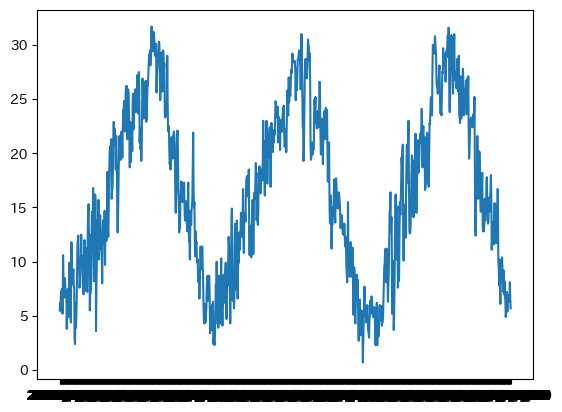

In [57]:
plt.plot(df["date"], df["mean_temparture"])
plt.show()

描画できましたがx軸の文字がつぶれています。<br>
グラフを拡大してみましょう。plt.figure()を使用することでグラフサイズが調整できます。<br>

``` python
plt.figure(figsize=(x軸の幅, y軸の高さ))
```

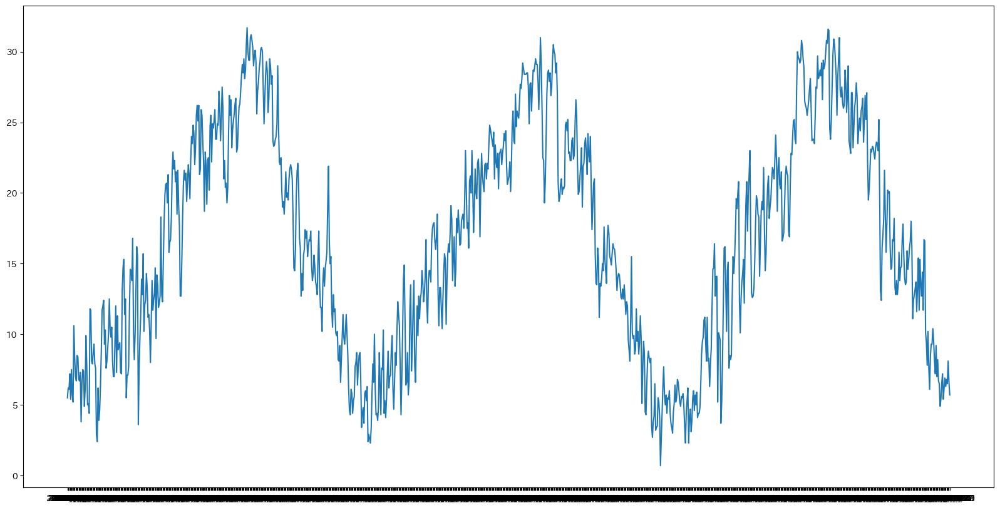

In [58]:
plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"])
plt.show()

拡大してみましたが、それでも文字がつぶれてしまっています。<br>
メモリの数が多すぎるため、減らしてみましょう。メモリの設定はxticks()とyticks()で可能です。<br>

```python
plt.xticks([x軸のメモリラベルのリスト])
plt.yticks([y軸のメモリラベルのリスト])
```

まずx軸ラベル用のリストを作成します。

In [59]:
x_ticks_list = []
years =["2020", "2021", "2022"]
months = ["2", "4", "6", "8", "10", "12"]

for y in years:
    for m in months:
        x_ticks_list.append(y + "/" + m + "/1")
        
print(x_ticks_list)

['2020/2/1', '2020/4/1', '2020/6/1', '2020/8/1', '2020/10/1', '2020/12/1', '2021/2/1', '2021/4/1', '2021/6/1', '2021/8/1', '2021/10/1', '2021/12/1', '2022/2/1', '2022/4/1', '2022/6/1', '2022/8/1', '2022/10/1', '2022/12/1']


x軸のメモリ用のリストができたのであとは設定するだけです。

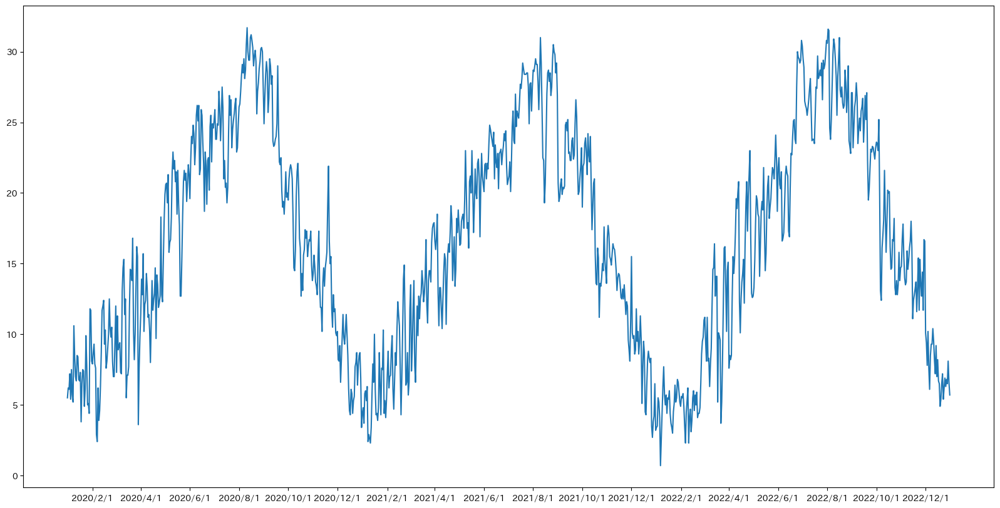

In [60]:
plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"])
plt.xticks(x_ticks_list) # 追加
plt.show()

一応それらしくなりましたが、x軸とy軸がそれぞれなんの値かがわかりません。<br>
x軸、y軸のラベルはそれぞれxlabel()、ylabel()を使用します。<br>
また、ラベル名に限りませんが、文字サイズを調整したい場合、引数にオプションとしてfontsizeが指定できます。

``` python
plt.xlabel("x軸のラベル名", fontsize=フォントサイズ)
plt.ylabel("y軸のラベル名", fontsize=フォントサイズ)
```

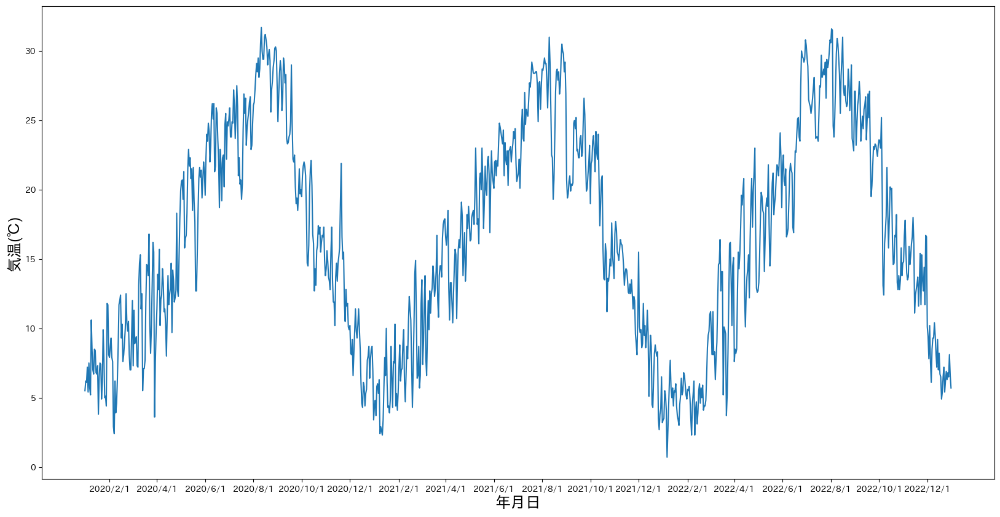

In [61]:
x_ticks_list = []
years =["2020", "2021", "2022"]
months = ["2", "4", "6", "8", "10", "12"]

for y in years:
    for m in months:
        x_ticks_list.append(y + "/" + m + "/1")

plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"])
plt.xticks(x_ticks_list)
plt.xlabel("年月日", fontsize=18) # 追加
plt.ylabel("気温(℃)", fontsize=18) # 追加
plt.show()

複数のグラフをまとめて表示したい場合もあります。<br>
グラフの線を追加する場合はplt.plot()を追加しましょう。<br>

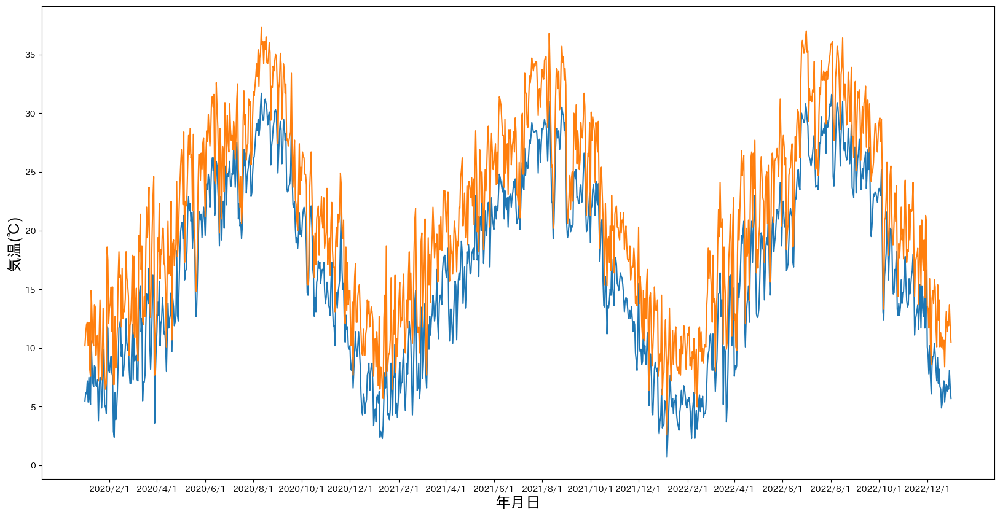

In [62]:
x_label = []
years =["2020", "2021", "2022"]
months = ["2", "4", "6", "8", "10", "12"]

for y in years:
    for m in months:
        x_label.append(y + "/" + m + "/1")

plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"])
plt.plot(df["date"], df["max_temparture"])  # 追加
plt.xticks(x_label)
plt.xlabel("年月日", fontsize=18)
plt.ylabel("気温(℃)", fontsize=18)
plt.show()

上のグラフだと各色の線がなんのグラフを表しているかわからないので凡例を追加してみます。<br>
plot()の時に各線にlabelを付けておき、legend()で凡例が表示されます。<br>

``` python
plt.plot(x軸のリスト, y軸のリスト, label="凡例1")
plt.plot(x軸のリスト, y軸のリスト, label="凡例2")
plt.legend()
```

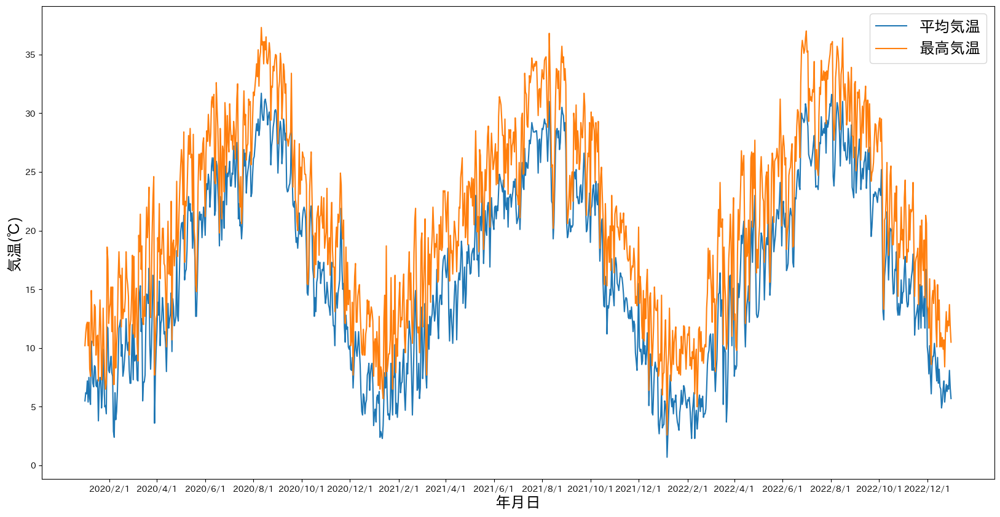

In [63]:
x_label = []
years =["2020", "2021", "2022"]
months = ["2", "4", "6", "8", "10", "12"]

for y in years:
    for m in months:
        x_label.append(y + "/" + m + "/1")

plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"], label="平均気温") #変更
plt.plot(df["date"], df["max_temparture"], label="最高気温")  #変更
plt.xticks(x_label)
plt.xlabel("年月日", fontsize=18)
plt.ylabel("気温(℃)", fontsize=18)
plt.legend(fontsize=18) # 追加
plt.show()

次にグラフタイトルを付けてみます。title()で設定できます。

``` python
plt.title("タイトル名")
```

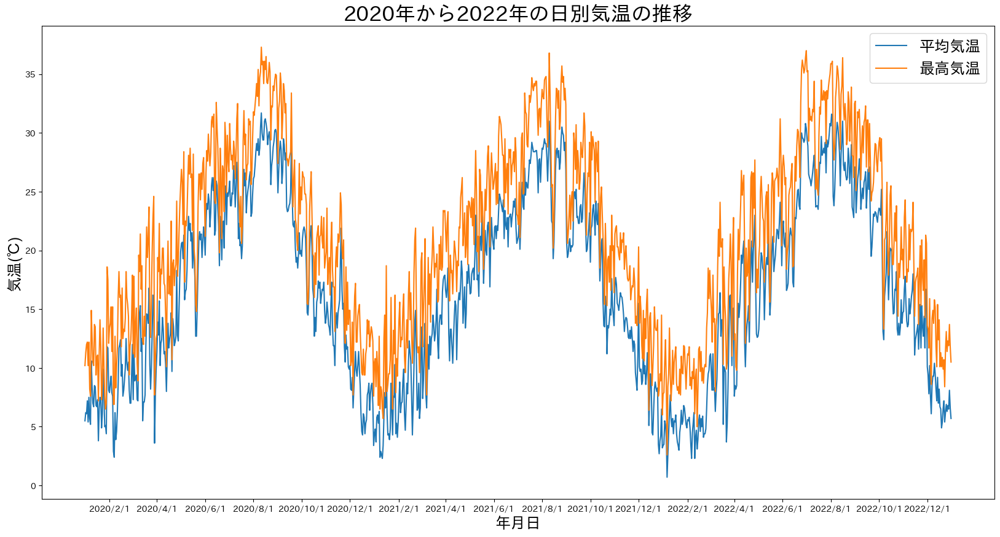

In [64]:
x_label = []
years =["2020", "2021", "2022"]
months = ["2", "4", "6", "8", "10", "12"]

for y in years:
    for m in months:
        x_label.append(y + "/" + m + "/1")

plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"], label="平均気温")
plt.plot(df["date"], df["max_temparture"], label="最高気温")
plt.xticks(x_label)
plt.xlabel("年月日", fontsize=18)
plt.ylabel("気温(℃)", fontsize=18)
plt.legend(fontsize=18)
plt.title("2020年から2022年の日別気温の推移", fontsize=24) # 追加
plt.show()

次はグラフの線のスタイルを変更してみましょう。plot()時のオプションでlinestyleを指定することで線の種類が指定できます。<br>
線の種類は以下から選択できます。

|linestyle|種類|
|--|--|
|"solid"|実線(デフォルト)|
|"dotted"|点線|
|"dashed"|破線|
|"dashdot"|一点鎖線|

また、線の色と太さ、透明度も変更できます。太さはlinewidth、色はcolor、透明度はalphaで指定できます。

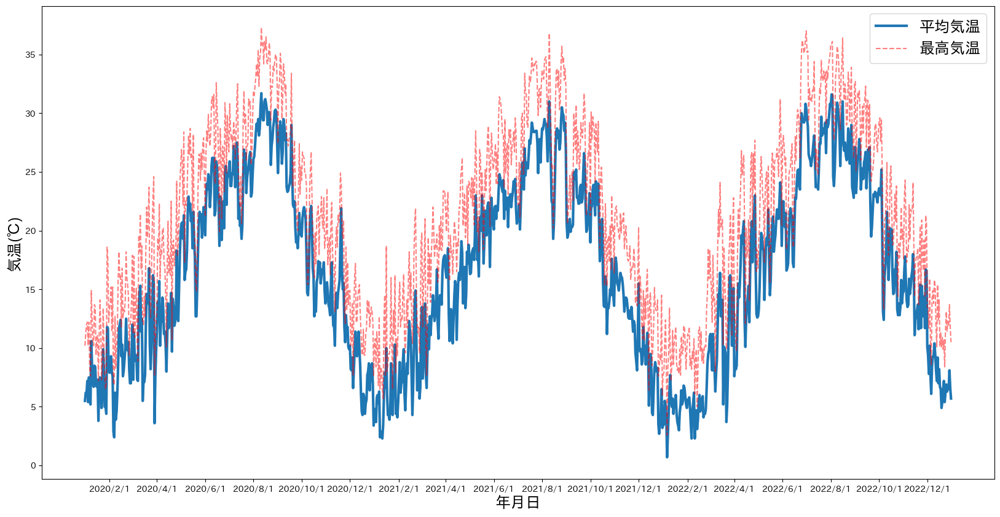

In [65]:
x_label = []
years =["2020", "2021", "2022"]
months = ["2", "4", "6", "8", "10", "12"]

for y in years:
    for m in months:
        x_label.append(y + "/" + m + "/1")

plt.figure(figsize=(20, 10))
plt.plot(df["date"], df["mean_temparture"], label="平均気温", linestyle="solid", linewidth=3) #変更
plt.plot(df["date"], df["max_temparture"], label="最高気温", linestyle="dashed", color="red", alpha=0.5)  #変更
plt.xticks(x_label)
plt.xlabel("年月日", fontsize=18)
plt.ylabel("気温(℃)", fontsize=18)
plt.legend(fontsize=18)
plt.show()

このようにmatplotlibでは様々なオプションを駆使して柔軟なグラフ描画が可能です。<br>
pandasの時と同様でこれら全てを覚えておく必要は全くありませんがどんなことができるかを何となくつかんでおきましょう。

## 5-2.様々なグラフの種類

今までは単純な線でのグラフのグラフの描画でしたが、matplotlibでは棒グラフや円グラフなど様々なグラフの描画が可能です。<br>

下記例は棒グラフを描画します。plot()の代わりにbar()を使用することで棒グラフが描画できます。

``` python
plt.bar(x軸のリスト, y軸のリスト)
```

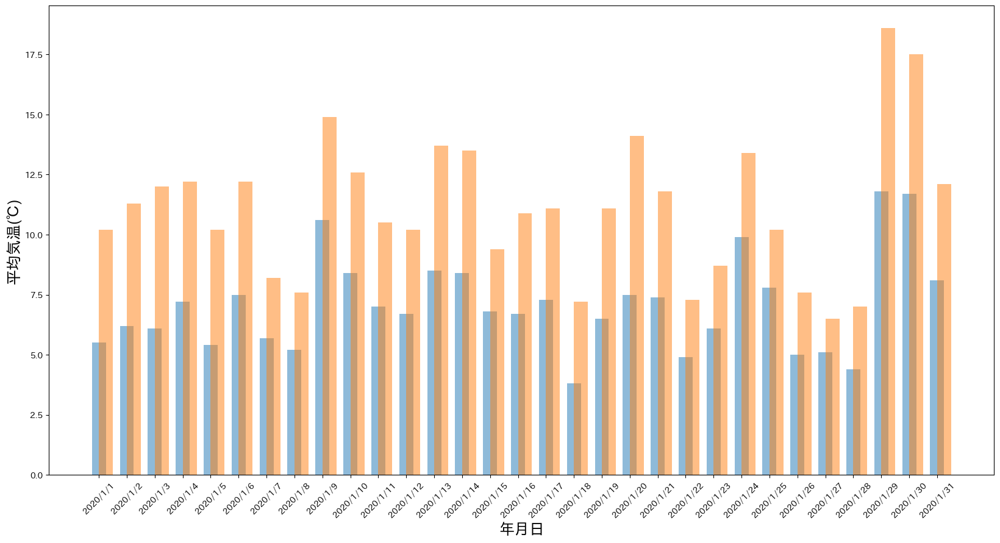

In [66]:
plt.figure(figsize=(20, 10))
plt.bar(df["date"][:31], df["mean_temparture"][:31], width=0.5, alpha=0.5, align = "center")
plt.bar(df["date"][:31], df["max_temparture"][:31], width=0.5, alpha=0.5, align="edge")
plt.xlabel("年月日", fontsize=18)
plt.ylabel("平均気温(℃)", fontsize=18)
plt.xticks(rotation=45) # ラベルの向きを45°回転
plt.show()

下記例は散布図の描画例です。plot()の代わりにscatter()を使用します。

``` python
plt.scatter(x軸のリスト, y軸のリスト, s=マーカーのサイズ)
```

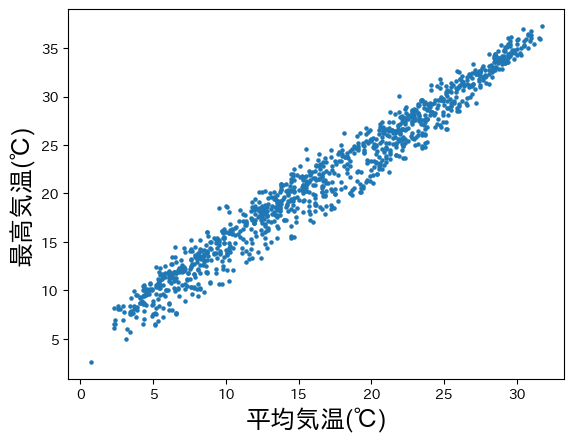

In [67]:
plt.scatter(df["mean_temparture"], df["max_temparture"], s=5)
plt.xlabel("平均気温(℃)", fontsize=18)
plt.ylabel("最高気温(℃)", fontsize=18)
plt.show()

次はヒストグラムの例です。<br>
binsというオプションを指定することで、分割数を指定できます。

``` python
plt.hist([ヒストグラムにしたいリスト], bins=分割数)
```

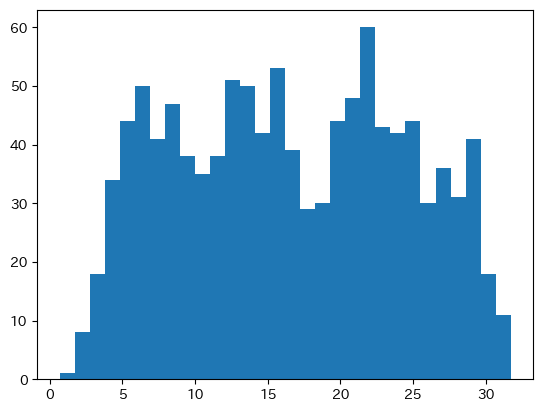

In [68]:
plt.hist(df["mean_temparture"], bins=30)
plt.show()

分割数指定せず、binsにリスト形式で閾値設定が可能です。<br>

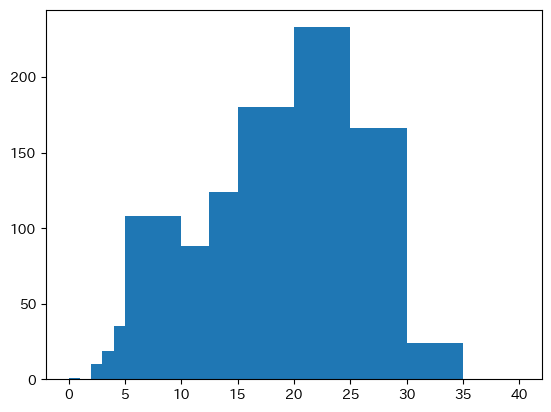

In [69]:
plt.hist(df["mean_temparture"], bins=[0, 1, 2, 3, 4, 5, 7.5, 10, 12.5, 15, 20, 25, 30, 35, 40])
plt.show()

円グラフの例です。<br>


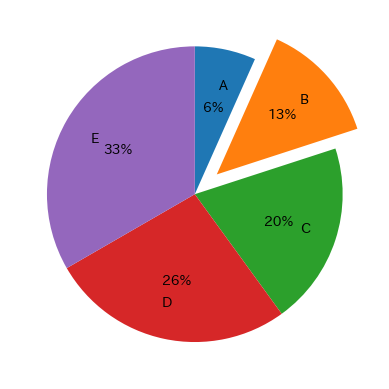

In [70]:
plt.pie(
    [10, 20, 30, 40, 50], 
    explode=[0, 0.2, 0, 0, 0],
    labels=["A", "B", "C", "D", "E"],
    labeldistance=0.75,
    autopct="%d%%",
    startangle=90, 
    counterclock=False
)
plt.show()

## 5-3. matplotlibにおける2つの派閥 - pyplot派とオブジェクト指向派-

matplotlibは同じグラフの描画であっても多様な記述が可能な半面、体系的に学ぼうとすると情報が散在しています。<br>
そのため、人によって書き方が異なるというケースが多く、混乱しやすいです。<br>

特に初学者が混乱するのがmatplotlibでは記述方式に以下の２種類の派閥が存在しているということです。<br>
- pyplot派
- オブジェクト指向派

ここまで紹介してきた記述方法は全てpyplot派でした。matlabと近いシンプルな記述が可能であるという特徴があります。<br>
一方のオブジェクト指向派は記述が若干複雑になりますが、より細かい設定が可能です。<br>
オブジェクト指向派の記述方式は、複数グラフをまとめて描画したいときに使用されます。<br>

まずは複数グラフを描画するためにまずは下記の通りデータを用意します。

In [71]:
# リストの各要素に対して特定の操作を行うためのコールバック関数
def callback(input_list, func):
    output_list = []
    for i in input_list:
        output_list.append(func(i))
    return output_list

# y = 3x+2
def func_1(value):
    return 3 * value + 2

# y = 2x^2 - 5
def func_2(value):
    return 2 * value ** 2 - 5 

# y = (x+1)^(1/2)
def func_3(value):
    return round((value+1) ** 0.5, 3)

# y = -x^3 - 2x^2 + 100
def func_4(value):
    return - (value ** 3) - 2 * value ** 2 + 100

# y = 10
def func_5(value):
    return 10

# y = 0 (x < 5), 10 (x >= 5)
def func_6(value):
    if value < 5:
        return 0
    else:
        return 10
    

x = list(range(10))
y_list = []
y_list.append({"value": callback(x, func_1), "title": "y1 = 3x+2"})
y_list.append({"value": callback(x, func_2), "title": "y2 = 2x^2 - 5"})
y_list.append({"value": callback(x, func_3), "title": "y3 = (x+1)^(1/2)"})
y_list.append({"value": callback(x, func_4), "title": "y4 = -x^3 - 2x^2 + 100"})
y_list.append({"value": callback(x, func_5), "title": "y5 = 10"})
y_list.append({"value": callback(x, func_6), "title": "y6 = 0 (x < 5), 10 (x >= 5)"})

print("x:", x)
for y in y_list:
    print(y["title"], ":", y["value"])

x: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
y1 = 3x+2 : [2, 5, 8, 11, 14, 17, 20, 23, 26, 29]
y2 = 2x^2 - 5 : [-5, -3, 3, 13, 27, 45, 67, 93, 123, 157]
y3 = (x+1)^(1/2) : [1.0, 1.414, 1.732, 2.0, 2.236, 2.449, 2.646, 2.828, 3.0, 3.162]
y4 = -x^3 - 2x^2 + 100 : [100, 97, 84, 55, 4, -75, -188, -341, -540, -791]
y5 = 10 : [10, 10, 10, 10, 10, 10, 10, 10, 10, 10]
y6 = 0 (x < 5), 10 (x >= 5) : [0, 0, 0, 0, 0, 10, 10, 10, 10, 10]


0から9の値をとるxのリストに対して、y1~y6は上のような値をとるリストとなります。<br>
plt派の記述方法だと以下のような書き方でまとめてグラフ描画することができます。

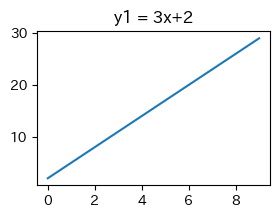

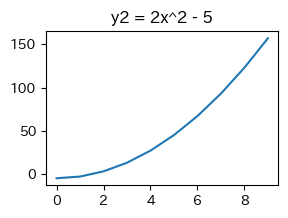

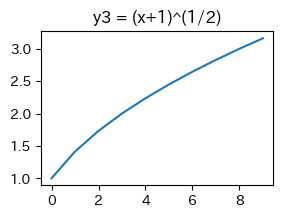

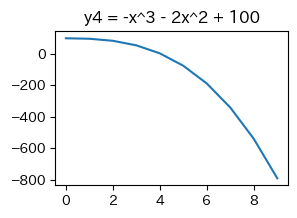

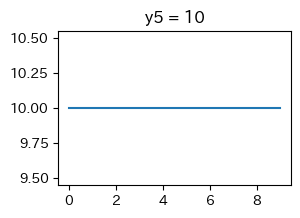

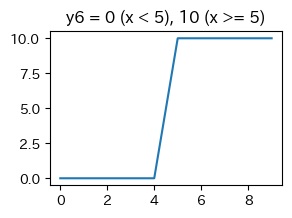

In [72]:
for y in y_list:
    plt.figure(figsize=(3, 2))
    plt.plot(x, y["value"])
    plt.title(y["title"])
    plt.show()

このような書き方の場合は全てのグラフが縦に連なってしまうためまとめて比較する際に不便です。<br>
そのため、オブジェクト指向派の書き方で縦横にグラフを並べてみます。<br>


下記はplt.subplots()を使用した例です。<br>
戻り値にfig, axの2つを取得していますが、figでは描画領域全体の設定をして<br>
axでは各グラフの描画設定を行います。

``` python
fig, ax = plt.subplots(行数, 列数)
ax[行インデックス][列インデックス].plot()
ax[行インデックス][列インデックス].plot()
・
・
・
fig.show()
```

pltの時と異なり、titleやticksの設定をする際はメソッドの接頭語に**set_** がつくことが多いです。

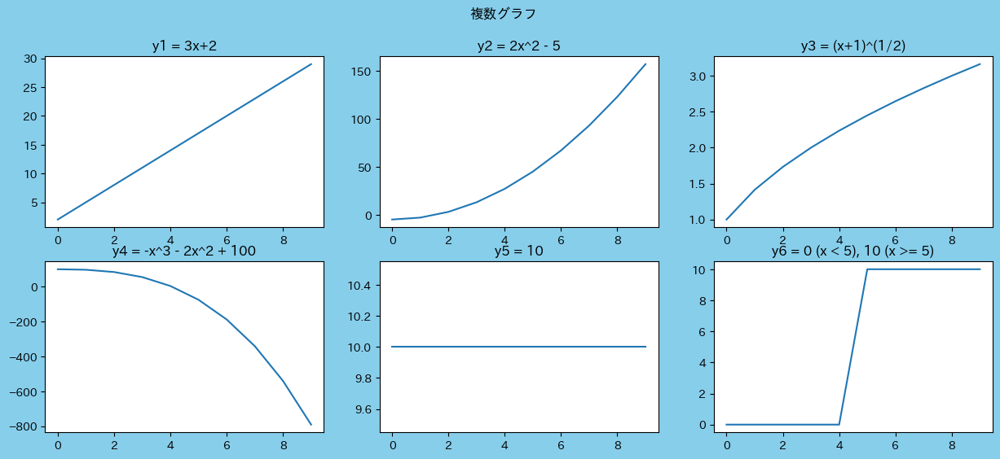

In [73]:
fig, ax = plt.subplots(2, 3, figsize=(15, 6), facecolor="skyblue")

ax[0][0].plot(x, y_list[0]["value"])
ax[0][0].set_title(y_list[0]["title"])

ax[0][1].plot(x, y_list[1]["value"])
ax[0][1].set_title(y_list[1]["title"])

ax[0][2].plot(x, y_list[2]["value"])
ax[0][2].set_title(y_list[2]["title"])

ax[1][0].plot(x, y_list[3]["value"])
ax[1][0].set_title(y_list[3]["title"])

ax[1][1].plot(x, y_list[4]["value"])
ax[1][1].set_title(y_list[4]["title"])

ax[1][2].plot(x, y_list[5]["value"])
ax[1][2].set_title(y_list[5]["title"])

fig.suptitle("複数グラフ")
fig.show()

下記はadd_subplot()を使用した例です。<br>
これは描画領域figに対して、行列の分割数と配置場所を指定する方法です。<br>
subplots()の場合はあらかじめ行列の分割数を指定して、plot時にインデックスを指定しますが、<br>
こちらはplot時に分割数とインデックスを同時に指定します。<br>
**インデックスが1から始まる**という点が注意すべき点です。

``` python
fig = plt.figure()
ax = fig.add_subplot(行数, 列数, インデックス)
ax.plot()
・
・
・
fig.show()
```

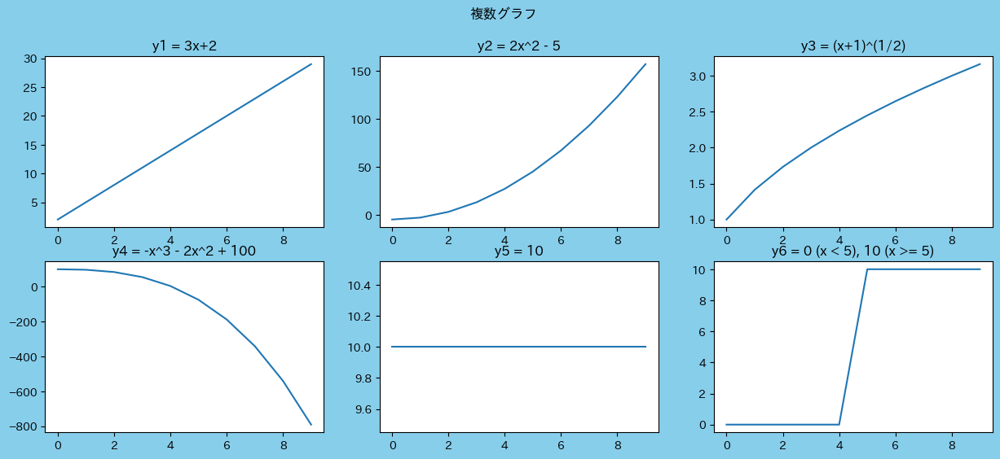

In [74]:
fig = plt.figure(figsize=(15, 6), facecolor="skyblue")

ax1 = fig.add_subplot(2, 3, 1)
ax1.plot(x, y_list[0]["value"])
ax1.set_title(y_list[0]["title"])

ax2 = fig.add_subplot(2, 3, 2)
ax2.plot(x, y_list[1]["value"])
ax2.set_title(y_list[1]["title"])

ax3 = fig.add_subplot(2, 3, 3)
ax3.plot(x, y_list[2]["value"])
ax3.set_title(y_list[2]["title"])

ax4 = fig.add_subplot(2, 3, 4)
ax4.plot(x, y_list[3]["value"])
ax4.set_title(y_list[3]["title"])

ax5 = fig.add_subplot(2, 3, 5)
ax5.plot(x, y_list[4]["value"])
ax5.set_title(y_list[4]["title"])

ax6 = fig.add_subplot(2, 3, 6)
ax6.plot(x, y_list[5]["value"])
ax6.set_title(y_list[5]["title"])

fig.suptitle("複数グラフ")
fig.show()

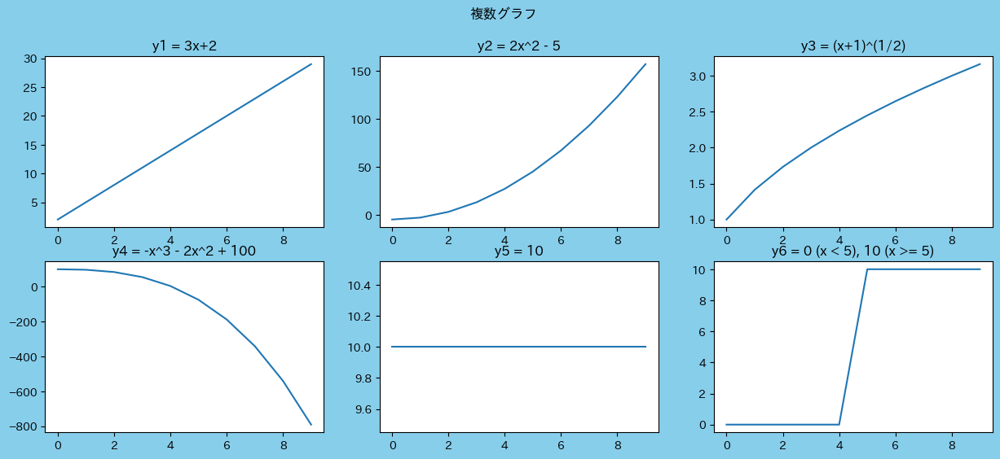

In [75]:
fig = plt.figure(figsize=(15, 6), facecolor="skyblue")

for i in range(0, len(y_list), 1):
    ax = fig.add_subplot(2, 3, i+1)
    ax.plot(x, y_list[i]["value"])
    ax.set_title(y_list[i]["title"])

fig.suptitle("複数グラフ")
fig.show()


![階層構造](../img/matplotlib_1.png)

## 5-4. アニメーションの描画

matplotlibはアニメーションの描画も可能です。<br>
アニメーションの描画は、通常のグラフ描画処理を一つの関数として扱い、コマ送りにして描画するFuncAnimation()を使用するケースが多いです。

In [76]:
import numpy as np
import matplotlib.animation as anime
from IPython.display import HTML

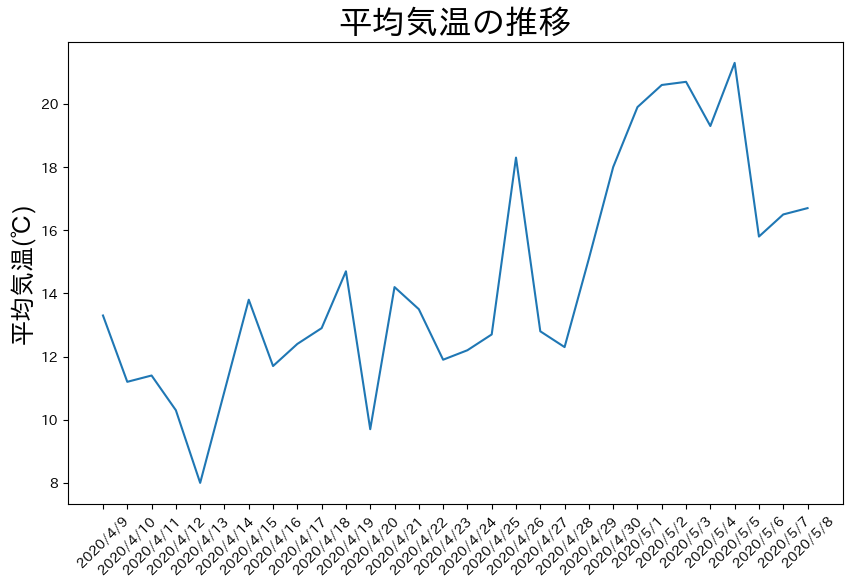

In [77]:
fig = plt.figure(figsize=(10, 6))

def update(i, date_list, mean_temparture_list):
    plt.cla()
    plt.title("平均気温の推移", fontsize=24)
    plt.ylabel("平均気温(℃)", fontsize=18)
    plt.xticks(rotation=45)
    return plt.plot(date_list[i:i+30], mean_temparture_list[i:i+30])

anm = anime.FuncAnimation(fig, update, fargs=(list(df["date"]), list(df["mean_temparture"])), interval = 100, frames = 100, blit=True)
HTML(anm.to_jshtml())

## 5-5. 3Dグラフの描画

matplotlibは3Dグラフも描画できます。<br>
あまり深堀した説明はしません(できません)が、matplotlibを利用すればこんなことが可能である。<br>
といったイメージを持つことが重要です。

In [78]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

In [79]:
%%bash
wget -q https://download.mlcc.google.com/mledu-datasets/california_housing_train.csv

In [80]:
df_housing = pd.read_csv("california_housing_train.csv")
df_housing

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0
...,...,...,...,...,...,...,...,...,...
16995,-124.26,40.58,52.0,2217.0,394.0,907.0,369.0,2.3571,111400.0
16996,-124.27,40.69,36.0,2349.0,528.0,1194.0,465.0,2.5179,79000.0
16997,-124.30,41.84,17.0,2677.0,531.0,1244.0,456.0,3.0313,103600.0
16998,-124.30,41.80,19.0,2672.0,552.0,1298.0,478.0,1.9797,85800.0


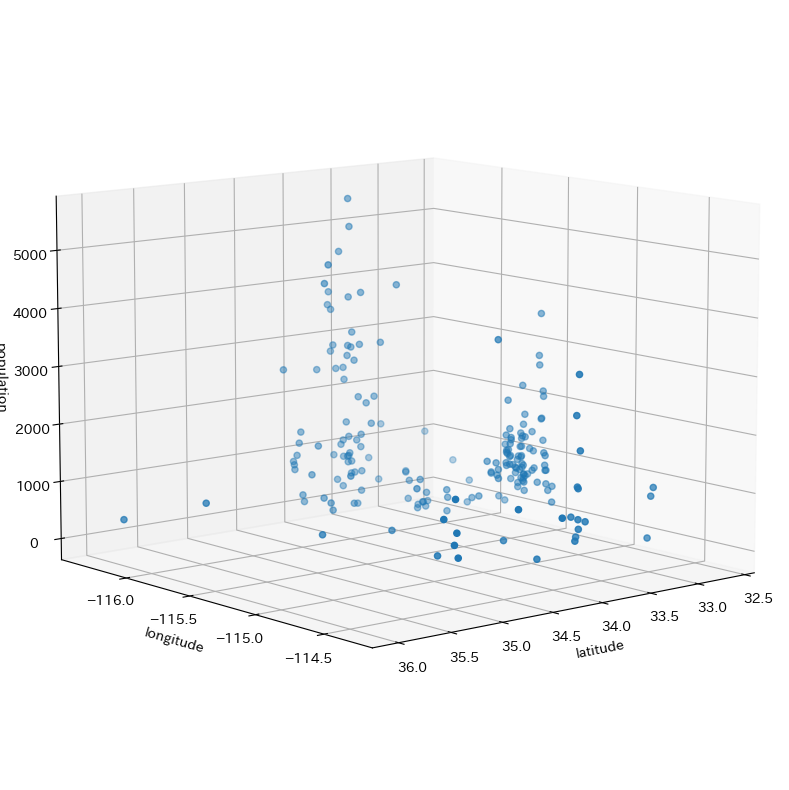

In [81]:
df_housing = df_housing[:200]

fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot(projection="3d")
ax.scatter(df_housing["latitude"], df_housing["longitude"], df_housing["population"])
ax.set_xlabel("latitude")
ax.set_ylabel("longitude")
ax.set_zlabel("population")
ax.view_init(elev=10, azim=50)
fig.show()

より実用的な例としては、避航におけるOZTの描画などに役立てられそうです。<br>
(numpyは次週説明する項目)

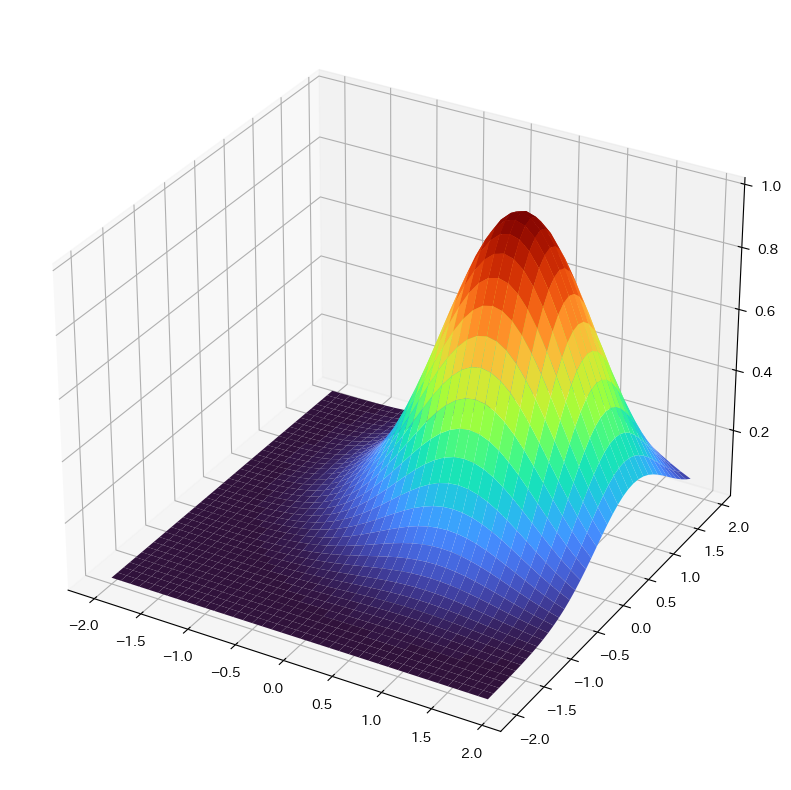

In [102]:
fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot(1, 1, 1, projection="3d")

x1 = 0.7
y1 = 0.7

x = np.arange(-2, 2, 0.1)
y = np.arange(-2, 2, 0.1)
x_grid, y_grid = np.meshgrid(x, y)
z = np.exp(-((x_grid-x1)**2 + (y_grid-y1)**2))
ax.plot_surface(x_grid, y_grid, z, rstride=1, cstride=1, cmap="turbo", linewidth=0.3)

fig.show()

さらに深堀し、アニメーション化してみました。

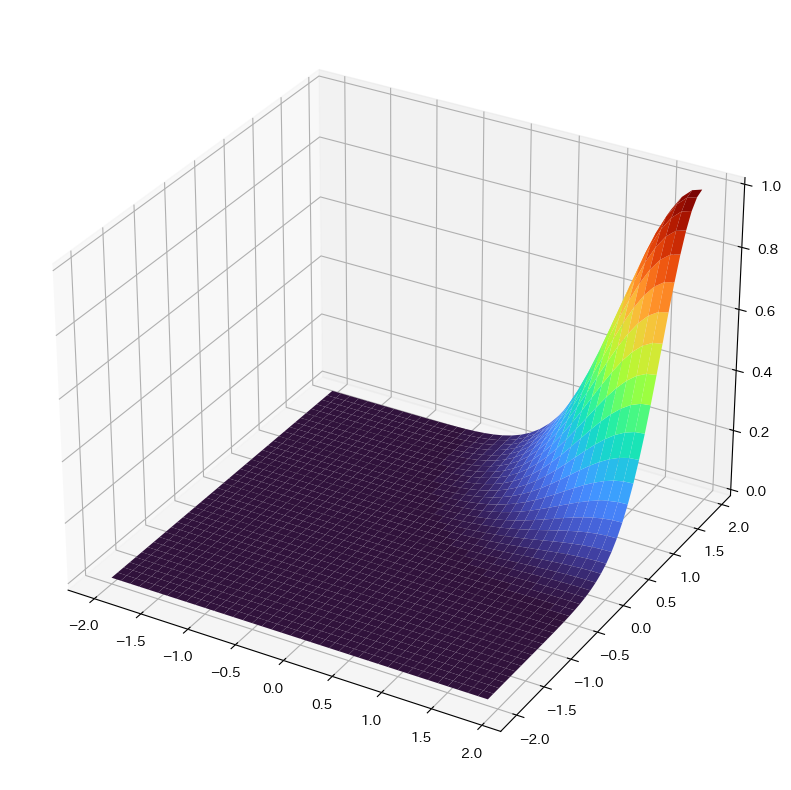

In [104]:
x = np.arange(-2, 2, 0.1)
y = np.arange(-2, 2, 0.1)
x_grid, y_grid = np.meshgrid(x, y)

x_pos_list = np.arange(-2, 2, 0.1)
y_pos_list = np.arange(-2, 2, 0.1)

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'), figsize=(15, 10))

def update(i, x_grid, y_grid, x_pos_list, y_pos_list):
    ax.cla()
    z = np.exp(-((x_grid-x_pos_list[i])**2 + (y_grid-y_pos_list[i])**2))
    return ax.plot_surface(x_grid, y_grid, z, rstride=1, cstride=1, cmap="turbo", linewidth=0.3),

anm = anime.FuncAnimation(fig, update, fargs=(x_grid, y_grid, x_pos_list, y_pos_list), interval = 100, frames = len(x_pos_list), blit=True)
HTML(anm.to_jshtml())

[練習問題](../practice/lesson5.ipynb)